In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn import metrics
import plotly.express as px
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

In [2]:
df = pd.read_csv("telecom_churn_data.csv")
df

,state,account length,area code,phone number,international plan,voice mail plan,number vmail messages,total day minutes,total day calls,total day charge,...,total eve calls,total eve charge,total night minutes,total night calls,total night charge,total intl minutes,total intl calls,total intl charge,customer service calls,churn
0,KS,128,415,382-4657,no,yes,25,265.1,110,45.07,...,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False
1,OH,107,415,371-7191,no,yes,26,161.6,123,27.47,...,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False
2,NJ,137,415,358-1921,no,no,0,243.4,114,41.38,...,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False
3,OH,84,408,375-9999,yes,no,0,299.4,71,50.90,...,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False
4,OK,75,415,330-6626,yes,no,0,166.7,113,28.34,...,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3328,AZ,192,415,414-4276,no,yes,36,156.2,77,26.55,...,126,18.32,279.1,83,12.56,9.9,6,2.67,2,False
3329,WV,68,415,370-3271,no,no,0,231.1,57,39.29,...,55,13.04,191.3,123,8.61,9.6,4,2.59,3,False
3330,RI,28,510,328-8230,no,no,0,180.8,109,30.74,...,58,24.55,191.9,91,8.64,14.1,6,3.81,2,False
3331,CT,184,510,364-6381,yes,no,0,213.8,105,36.35,...,84,13.57,139.2,137,6.26,5.0,10,1.35,2,False


In [3]:
#df = df.drop(['Users'], axis = 1)
df.head()

,state,account length,area code,phone number,international plan,voice mail plan,number vmail messages,total day minutes,total day calls,total day charge,...,total eve calls,total eve charge,total night minutes,total night calls,total night charge,total intl minutes,total intl calls,total intl charge,customer service calls,churn
0,KS,128,415,382-4657,no,yes,25,265.1,110,45.07,...,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False
1,OH,107,415,371-7191,no,yes,26,161.6,123,27.47,...,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False
2,NJ,137,415,358-1921,no,no,0,243.4,114,41.38,...,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False
3,OH,84,408,375-9999,yes,no,0,299.4,71,50.90,...,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False
4,OK,75,415,330-6626,yes,no,0,166.7,113,28.34,...,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False


In [4]:
df.describe()

,account length,area code,number vmail messages,total day minutes,total day calls,total day charge,total eve minutes,total eve calls,total eve charge,total night minutes,total night calls,total night charge,total intl minutes,total intl calls,total intl charge,customer service calls
count,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000
mean,101.064806,437.182418,8.099010,179.775098,100.435644,30.562307,200.980348,100.114311,17.083540,200.872037,100.107711,9.039325,10.237294,4.479448,2.764581,1.562856
std,39.822106,42.371290,13.688365,54.467389,20.069084,9.259435,50.713844,19.922625,4.310668,50.573847,19.568609,2.275873,2.791840,2.461214,0.753773,1.315491
min,1.000000,408.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,23.200000,33.000000,1.040000,0.000000,0.000000,0.000000,0.000000
25%,74.000000,408.000000,0.000000,143.700000,87.000000,24.430000,166.600000,87.000000,14.160000,167.000000,87.000000,7.520000,8.500000,3.000000,2.300000,1.000000
50%,101.000000,415.000000,0.000000,179.400000,101.000000,30.500000,201.400000,100.000000,17.120000,201.200000,100.000000,9.050000,10.300000,4.000000,2.780000,1.000000
75%,127.000000,510.000000,20.000000,216.400000,114.000000,36.790000,235.300000,114.000000,20.000000,235.300000,113.000000,10.590000,12.100000,6.000000,3.270000,2.000000
max,243.000000,510.000000,51.000000,350.800000,165.000000,59.640000,363.700000,170.000000,30.910000,395.000000,175.000000,17.770000,20.000000,20.000000,5.400000,9.000000


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3333 entries, 0 to 3332
Data columns (total 21 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   state                   3333 non-null   object 
 1   account length          3333 non-null   int64  
 2   area code               3333 non-null   int64  
 3   phone number            3333 non-null   object 
 4   international plan      3333 non-null   object 
 5   voice mail plan         3333 non-null   object 
 6   number vmail messages   3333 non-null   int64  
 7   total day minutes       3333 non-null   float64
 8   total day calls         3333 non-null   int64  
 9   total day charge        3333 non-null   float64
 10  total eve minutes       3333 non-null   float64
 11  total eve calls         3333 non-null   int64  
 12  total eve charge        3333 non-null   float64
 13  total night minutes     3333 non-null   float64
 14  total night calls       3333 non-null   

In [6]:
for i in df.columns:
    df[i] = df[i].fillna(df[i].mode()[0])
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3333 entries, 0 to 3332
Data columns (total 21 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   state                   3333 non-null   object 
 1   account length          3333 non-null   int64  
 2   area code               3333 non-null   int64  
 3   phone number            3333 non-null   object 
 4   international plan      3333 non-null   object 
 5   voice mail plan         3333 non-null   object 
 6   number vmail messages   3333 non-null   int64  
 7   total day minutes       3333 non-null   float64
 8   total day calls         3333 non-null   int64  
 9   total day charge        3333 non-null   float64
 10  total eve minutes       3333 non-null   float64
 11  total eve calls         3333 non-null   int64  
 12  total eve charge        3333 non-null   float64
 13  total night minutes     3333 non-null   float64
 14  total night calls       3333 non-null   

In [7]:
objectDict = {}
for i in df.columns:
    if df[i].dtype == 'object' or df[i].dtype == 'bool':
        objectDict[i] = pd.Series(np.unique(df[i]))
objectDict

{'state': 0     AK
 1     AL
 2     AR
 3     AZ
 4     CA
 5     CO
 6     CT
 7     DC
 8     DE
 9     FL
 10    GA
 11    HI
 12    IA
 13    ID
 14    IL
 15    IN
 16    KS
 17    KY
 18    LA
 19    MA
 20    MD
 21    ME
 22    MI
 23    MN
 24    MO
 25    MS
 26    MT
 27    NC
 28    ND
 29    NE
 30    NH
 31    NJ
 32    NM
 33    NV
 34    NY
 35    OH
 36    OK
 37    OR
 38    PA
 39    RI
 40    SC
 41    SD
 42    TN
 43    TX
 44    UT
 45    VA
 46    VT
 47    WA
 48    WI
 49    WV
 50    WY
 dtype: object,
 'phone number': 0       327-1058
 1       327-1319
 2       327-3053
 3       327-3587
 4       327-3850
           ...   
 3328    422-7728
 3329    422-8268
 3330    422-8333
 3331    422-8344
 3332    422-9964
 Length: 3333, dtype: object,
 'international plan': 0     no
 1    yes
 dtype: object,
 'voice mail plan': 0     no
 1    yes
 dtype: object,
 'churn': 0    False
 1     True
 dtype: bool}

In [8]:
for i in objectDict.keys():
    for j in list(objectDict[i].index):
        df[i] = df[i].replace(objectDict[i][j], j)
df

,state,account length,area code,phone number,international plan,voice mail plan,number vmail messages,total day minutes,total day calls,total day charge,...,total eve calls,total eve charge,total night minutes,total night calls,total night charge,total intl minutes,total intl calls,total intl charge,customer service calls,churn
0,16,128,415,1926,0,1,25,265.1,110,45.07,...,99,16.78,244.7,91,11.01,10.0,3,2.70,1,0
1,35,107,415,1575,0,1,26,161.6,123,27.47,...,103,16.62,254.4,103,11.45,13.7,3,3.70,1,0
2,31,137,415,1117,0,0,0,243.4,114,41.38,...,110,10.30,162.6,104,7.32,12.2,5,3.29,0,0
3,35,84,408,1707,1,0,0,299.4,71,50.90,...,88,5.26,196.9,89,8.86,6.6,7,1.78,2,0
4,36,75,415,110,1,0,0,166.7,113,28.34,...,122,12.61,186.9,121,8.41,10.1,3,2.73,3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3328,3,192,415,3057,0,1,36,156.2,77,26.55,...,126,18.32,279.1,83,12.56,9.9,6,2.67,2,0
3329,49,68,415,1528,0,0,0,231.1,57,39.29,...,55,13.04,191.3,123,8.61,9.6,4,2.59,3,0
3330,39,28,510,42,0,0,0,180.8,109,30.74,...,58,24.55,191.9,91,8.64,14.1,6,3.81,2,0
3331,6,184,510,1331,1,0,0,213.8,105,36.35,...,84,13.57,139.2,137,6.26,5.0,10,1.35,2,0


In [9]:
px.box(df)

c:\Users\Sid\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning:

The figure layout has changed to tight



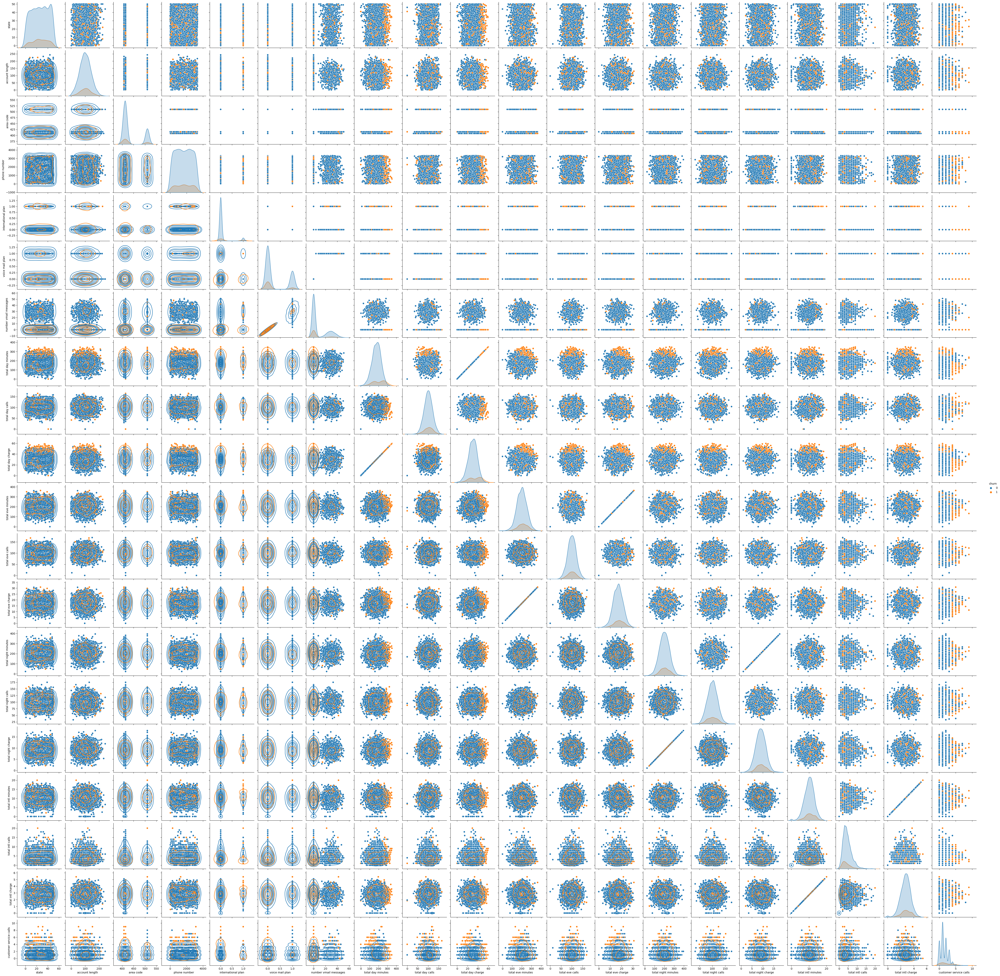

In [74]:
pairGrid = sns.pairplot(data = df, hue = "churn")
pairGrid.map_lower(sns.kdeplot)

Text(0.5, 1.0, '\nRaw Data Correlation Matrix\n')

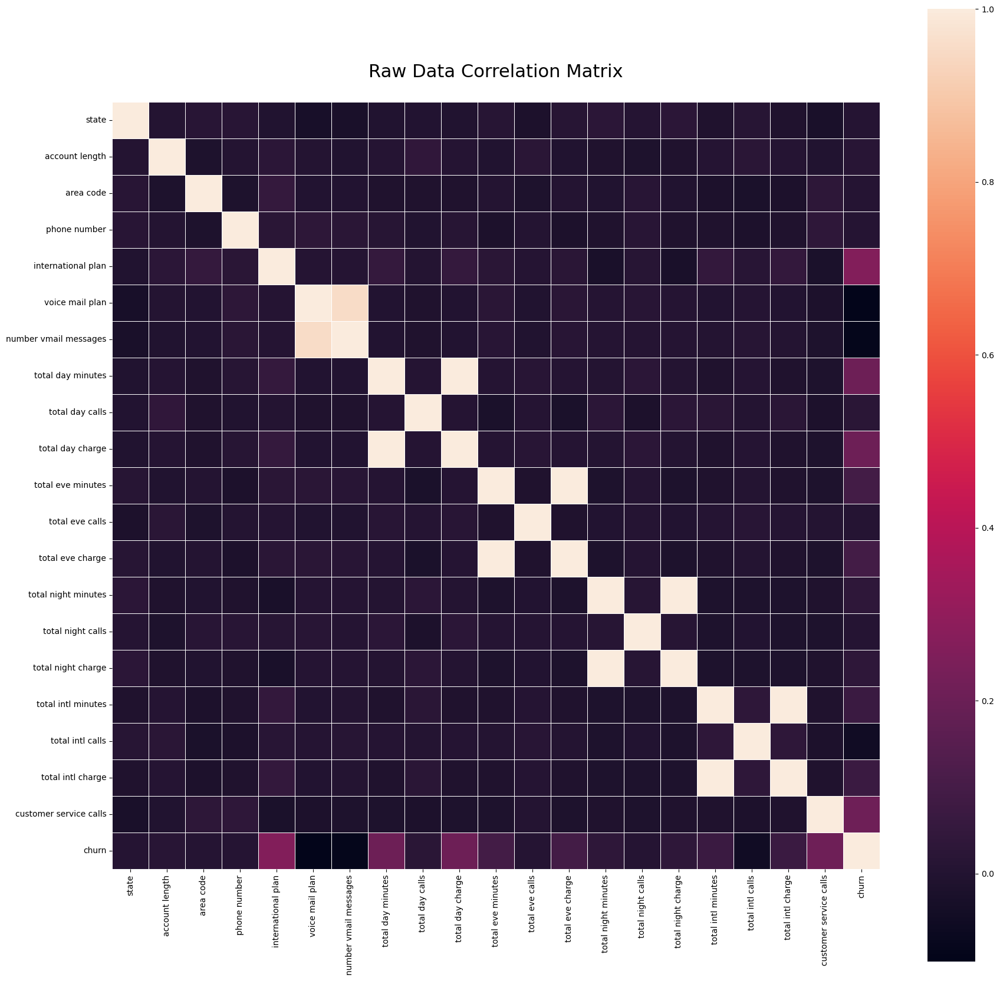

In [75]:
plt.figure(figsize=(df.corr().shape))
sns.color_palette("Spectral", as_cmap=True)
sns.heatmap(df.corr(), linewidths=.5, square = True)
plt.title("\nRaw Data Correlation Matrix\n", size = 22)

In [11]:
scaler = StandardScaler()
scaler.fit(df)
dfStd = scaler.transform(df)
dfStd = pd.DataFrame(dfStd, columns = df.columns)
dfStd

,state,account length,area code,phone number,international plan,voice mail plan,number vmail messages,total day minutes,total day calls,total day charge,...,total eve calls,total eve charge,total night minutes,total night calls,total night charge,total intl minutes,total intl calls,total intl charge,customer service calls,churn
0,-0.678649,0.676489,-0.523603,0.270227,-0.327580,1.617086,1.234883,1.566767,0.476643,1.567036,...,-0.055940,-0.070427,0.866743,-0.465494,0.866029,-0.085008,-0.601195,-0.085690,-0.427932,-0.411672
1,0.603170,0.149065,-0.523603,-0.094579,-0.327580,1.617086,1.307948,-0.333738,1.124503,-0.334013,...,0.144867,-0.107549,1.058571,0.147825,1.059390,1.240482,-0.601195,1.241169,-0.427932,-0.411672
2,0.333313,0.902529,-0.523603,-0.570595,-0.327580,-0.618396,-0.591760,1.168304,0.675985,1.168464,...,0.496279,-1.573900,-0.756869,0.198935,-0.755571,0.703121,0.211534,0.697156,-1.188218,-0.411672
3,0.603170,-0.428590,-0.688834,0.042613,3.052685,-0.618396,-0.591760,2.196596,-1.466936,2.196759,...,-0.608159,-2.743268,-0.078551,-0.567714,-0.078806,-1.303026,1.024263,-1.306401,0.332354,-0.411672
4,0.670634,-0.654629,-0.523603,-1.617204,3.052685,-0.618396,-0.591760,-0.240090,0.626149,-0.240041,...,1.098699,-1.037939,-0.276311,1.067803,-0.276562,-0.049184,-0.601195,-0.045885,1.092641,-0.411672
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3328,-1.555683,2.283878,-0.523603,1.445714,-0.327580,1.617086,2.038605,-0.432895,-1.167924,-0.433386,...,1.299506,0.286880,1.547039,-0.874374,1.547188,-0.120832,0.617898,-0.125496,0.332354,-0.411672
3329,1.547668,-0.830437,-0.523603,-0.143428,-0.327580,-0.618396,-0.591760,0.942447,-2.164631,0.942714,...,-2.264816,-0.938172,-0.189297,1.170023,-0.188670,-0.228304,-0.194831,-0.231645,1.092641,-0.411672
3330,0.873026,-1.835055,1.718817,-1.687879,-0.327580,-0.618396,-0.591760,0.018820,0.426808,0.019193,...,-2.114211,1.732349,-0.177431,-0.465494,-0.175486,1.383778,0.617898,1.387123,0.332354,-0.411672
3331,-1.353291,2.082955,1.718817,-0.348177,3.052685,-0.618396,-0.591760,0.624778,0.227466,0.625153,...,-0.808966,-0.815203,-1.219628,1.885562,-1.221396,-1.876211,2.243356,-1.876950,0.332354,-0.411672


In [12]:
px.box(dfStd)

Text(0.5, 1.0, '\nStandardScaled Data Correlation Matrix\n')

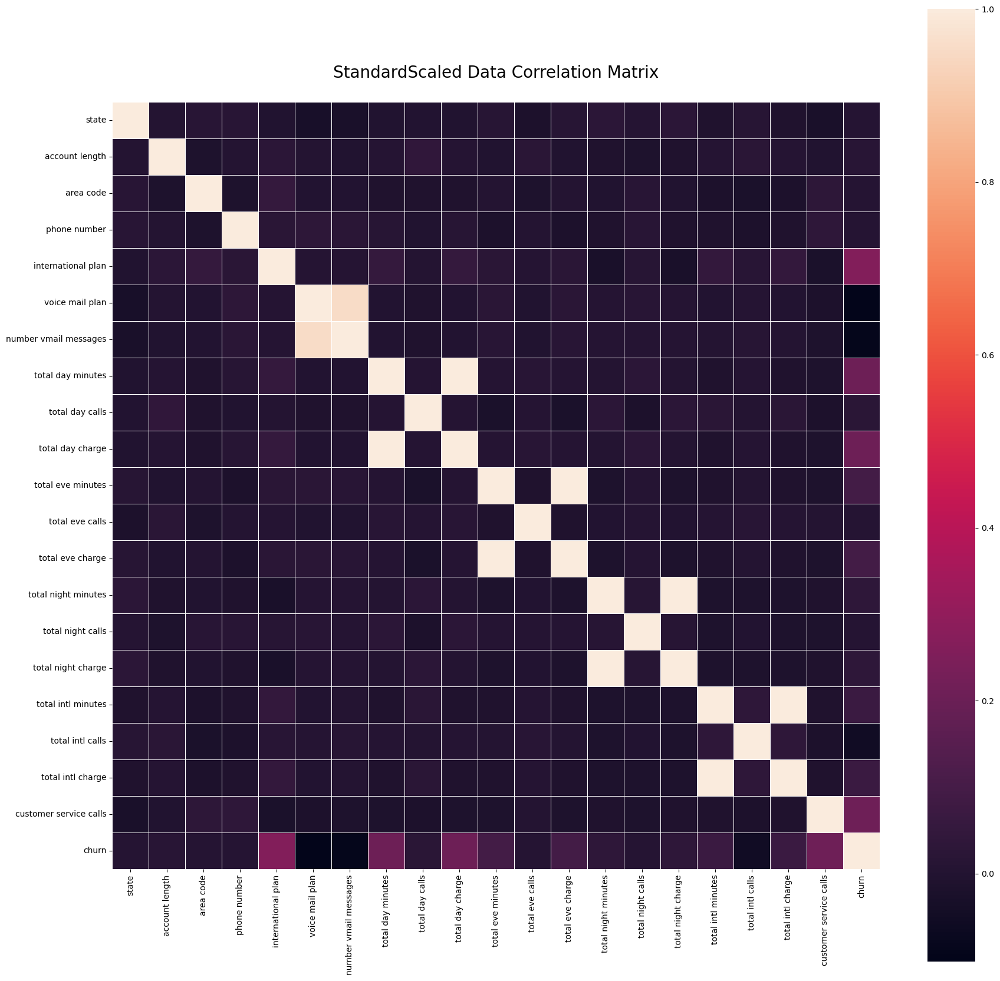

In [13]:
plt.figure(figsize=(df.corr().shape))
sns.heatmap(dfStd.corr(), linewidths=.5, square = True)
plt.title("\nStandardScaled Data Correlation Matrix\n", size = 20)

realStuff Comin' Up

In [23]:
scaler = StandardScaler()
scaler.fit(df.drop(['churn'], axis = 1))
stdStuff = scaler.transform(df.drop(['churn'], axis = 1))
stdStuff

array([[-0.6786493 ,  0.67648946, -0.52360328, ..., -0.60119509,
        -0.0856905 , -0.42793202],
       [ 0.6031696 ,  0.14906505, -0.52360328, ..., -0.60119509,
         1.2411686 , -0.42793202],
       [ 0.33331299,  0.9025285 , -0.52360328, ...,  0.21153386,
         0.69715637, -1.1882185 ],
       ...,
       [ 0.87302621, -1.83505538,  1.71881732, ...,  0.61789834,
         1.3871231 ,  0.33235445],
       [-1.35329082,  2.08295458,  1.71881732, ...,  2.24335625,
        -1.87695028,  0.33235445],
       [ 1.07541867, -0.67974475, -0.52360328, ..., -0.19483061,
         1.2411686 , -1.1882185 ]])

In [24]:
targetOut = df['churn'].values

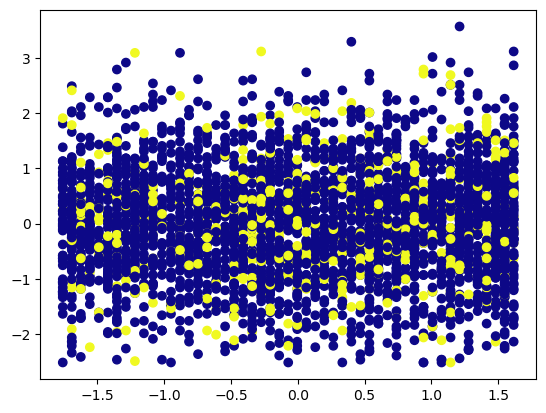

In [25]:
plt.scatter(stdStuff[:, 0], stdStuff[:, 1], c = targetOut, cmap = 'plasma')
plt.show()

In [26]:
xTrain, xTest, yTrain, yTest = train_test_split(stdStuff, targetOut, test_size = 0.2, random_state = 42)

In [27]:
regModel = LogisticRegression()
regModel.fit(xTrain, yTrain)
regScore = regModel.score(xTest, yTest)
regScore

0.8545727136431784

In [28]:
regPred = regModel.predict(xTest)
regPred

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

In [29]:
regCM = metrics.confusion_matrix(yTest, regPred)
regCM

array([[553,  13],
       [ 84,  17]], dtype=int64)

In [30]:
regAccuracy = metrics.accuracy_score(yTest, regPred)
print('Accuracy: ', regAccuracy)
regPrecision = metrics.precision_score(yTest, regPred, average = 'macro')
print('Precision: ', regPrecision)
regRecall = metrics.recall_score(yTest, regPred, average = 'macro')
print('Recall: ', regRecall)
regF1 = metrics.f1_score(yTest, regPred, average = 'macro')
print('F1 Score: ', regF1)

Accuracy:  0.8545727136431784
Precision:  0.7173992673992674
Recall:  0.5726743169016548
F1 Score:  0.5894551153921812


Text(0.5, 1.0, 'LogisticRegression (Before PCA) \nAccuracy: 0.8545727136431784, Precision: 0.7173992673992674\nRecall: 0.5726743169016548, F1_Score: 0.5894551153921812 ')

<Figure size 200x200 with 0 Axes>

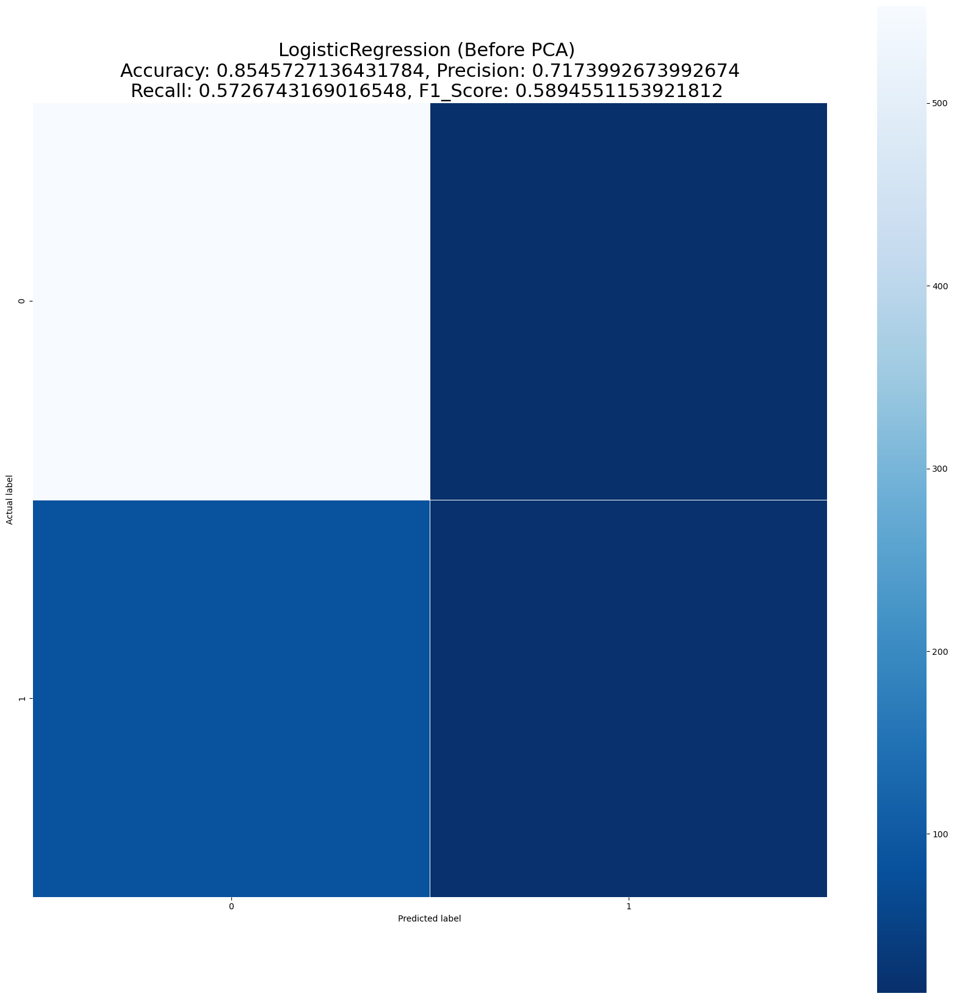

In [31]:
plt.figure(figsize=(regCM.shape))
plt.figure(figsize=(df.corr().shape))
sns.heatmap(regCM, linewidths=.5, square = True, cmap = 'Blues_r')
plt.ylabel('Actual label');
plt.xlabel('Predicted label');
titleStuff = 'LogisticRegression (Before PCA) \nAccuracy: {0}, Precision: {1}\nRecall: {2}, F1_Score: {3} '.format(regAccuracy, regPrecision, regRecall, regF1)
plt.title(titleStuff, size = 22)

In [32]:
rfModel = RandomForestClassifier()
rfModel.fit(xTrain, yTrain)
rfScore = rfModel.score(xTest, yTest)
rfScore

0.9505247376311844

In [33]:
rfPred = rfModel.predict(xTest)
rfPred

array([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,

In [34]:
rfCM = metrics.confusion_matrix(yTest, rfPred)
rfCM

array([[561,   5],
       [ 28,  73]], dtype=int64)

In [35]:
rfAccuracy = metrics.accuracy_score(yTest, rfPred)
print('Accuracy: ', rfAccuracy)
rfPrecision = metrics.precision_score(yTest, rfPred, average = 'macro')
print('Precision: ', rfPrecision)
rfRecall = metrics.recall_score(yTest, rfPred, average = 'macro')
print('Recall: ', rfRecall)
rfF1 = metrics.f1_score(yTest, rfPred, average = 'macro')
print('F1 Score: ', rfF1)

Accuracy:  0.9505247376311844
Precision:  0.9441796177789387
Recall:  0.8569691774831194
F1 Score:  0.893535514764565


Text(0.5, 1.0, 'RandomForest with ABN (Before PCA) \nAccuracy: 0.9505247376311844, Precision: 0.9441796177789387\nRecall: 0.8569691774831194, F1_Score: 0.893535514764565 ')

<Figure size 200x200 with 0 Axes>

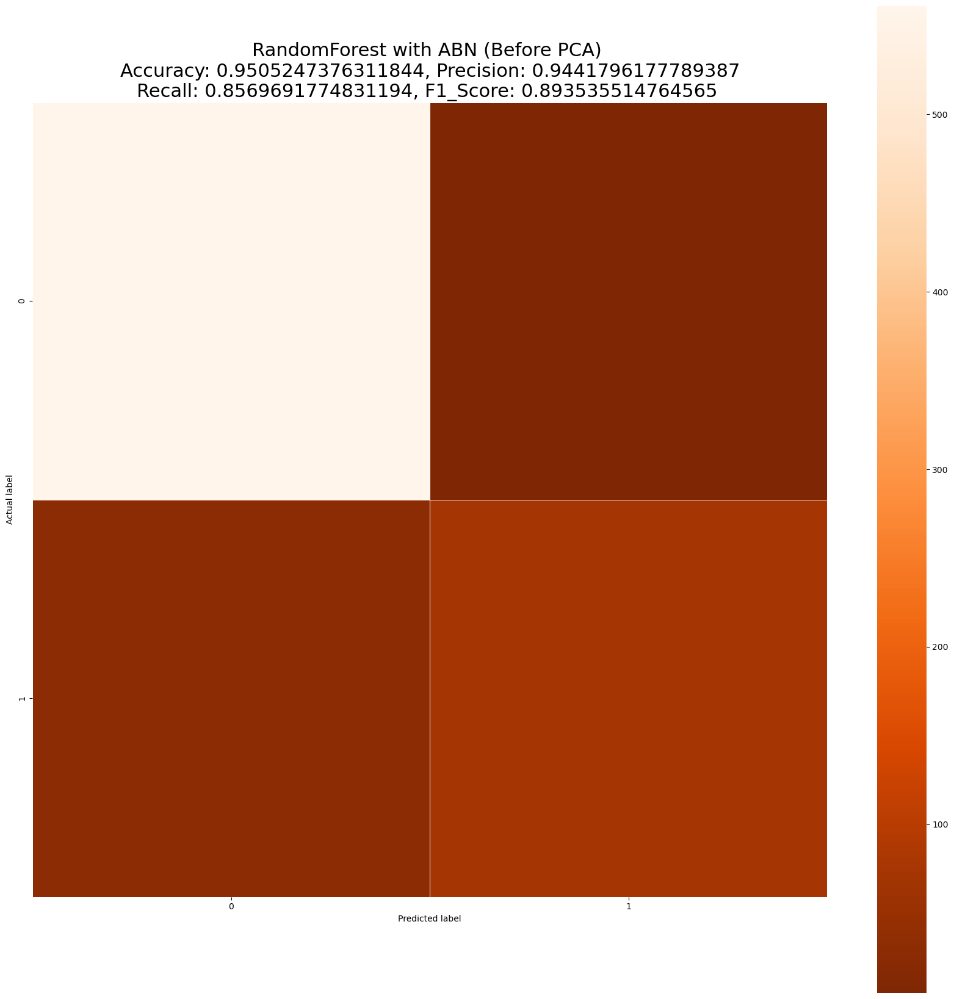

In [36]:
plt.figure(figsize=(rfCM.shape))
plt.figure(figsize=(df.corr().shape))
sns.heatmap(rfCM, linewidths=.5, square = True, cmap = 'Oranges_r')
plt.ylabel('Actual label')
plt.xlabel('Predicted label')
titleStuff = 'RandomForest with ABN (Before PCA) \nAccuracy: {0}, Precision: {1}\nRecall: {2}, F1_Score: {3} '.format(rfAccuracy, rfPrecision, rfRecall, rfF1)
plt.title(titleStuff, size = 22)

In [37]:
knnModel = KNeighborsClassifier(n_neighbors=25)
knnModel.fit(xTrain, yTrain)
knnScore = knnModel.score(xTest, yTest)
knnScore

0.8710644677661169

In [38]:
knnPred = knnModel.predict(xTest)
knnPred

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,

In [39]:
knnCM = metrics.confusion_matrix(yTest, knnPred)
knnCM

array([[565,   1],
       [ 85,  16]], dtype=int64)

In [40]:
knnAccuracy = metrics.accuracy_score(yTest, knnPred)
print('Accuracy: ', knnAccuracy)
knnPrecision = metrics.precision_score(yTest, knnPred, average = 'macro')
print('Precision: ', knnPrecision)
knnRecall = metrics.recall_score(yTest, knnPred, average = 'macro')
print('Recall: ', knnRecall)
knnF1 = metrics.f1_score(yTest, knnPred, average = 'macro')
print('F1 Score: ', knnF1)

Accuracy:  0.8710644677661169
Precision:  0.9052036199095023
Recall:  0.5783245285659308
F1 Score:  0.6002313782337199


Text(0.5, 1.0, 'KNN (Before PCA) \nAccuracy: 0.8710644677661169, Precision: 0.9052036199095023\nRecall: 0.5783245285659308, F1_Score: 0.6002313782337199 ')

<Figure size 200x200 with 0 Axes>

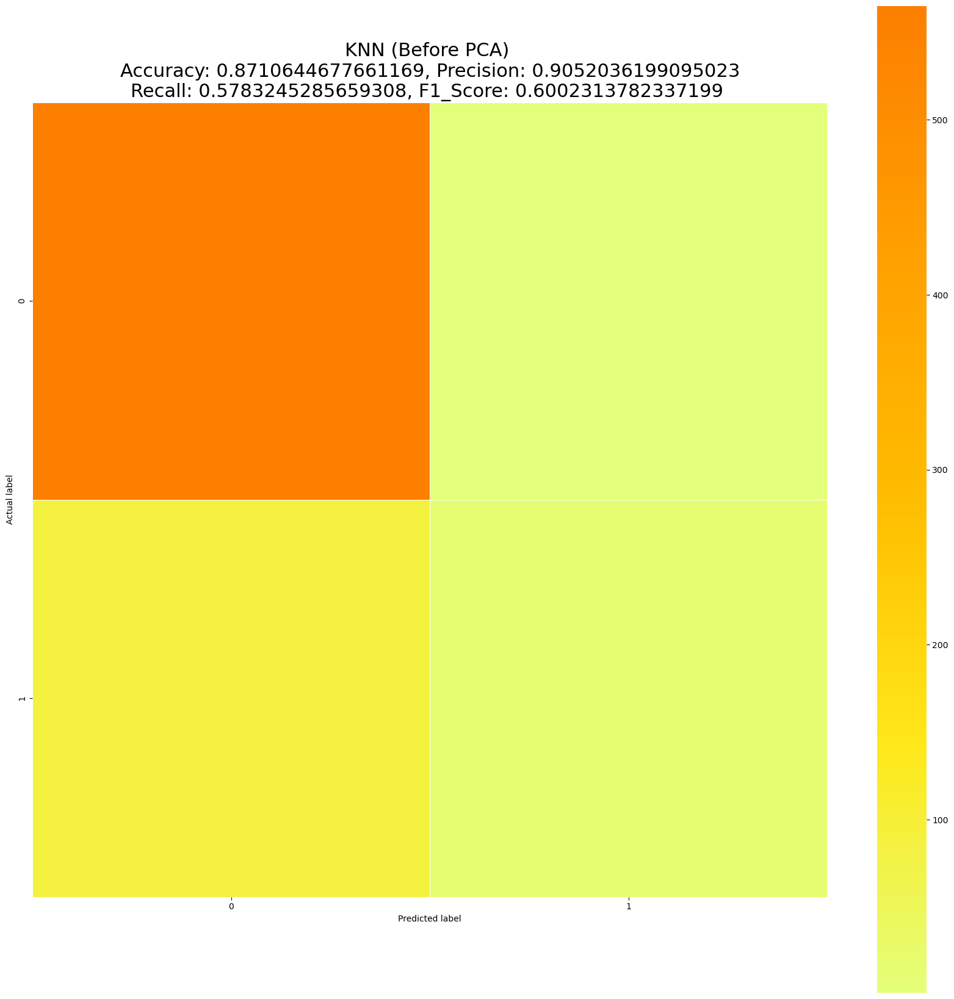

In [41]:
plt.figure(figsize=(knnCM.shape))
plt.figure(figsize=(df.corr().shape))
sns.heatmap(knnCM, linewidths=.5, square = True, cmap = 'Wistia')
plt.ylabel('Actual label')
plt.xlabel('Predicted label')
titleStuff = 'KNN (Before PCA) \nAccuracy: {0}, Precision: {1}\nRecall: {2}, F1_Score: {3} '.format(knnAccuracy, knnPrecision, knnRecall, knnF1)
plt.title(titleStuff, size = 22)

In [42]:
pca = PCA(0.95)
pca.fit(stdStuff)

PCA(n_components=0.95)

In [43]:
xPca = pca.transform(stdStuff)
print(xPca)
print('\n\n',xPca.shape)

[[ 1.87339992 -0.26016363 -1.21444991 ... -0.22090235 -0.09449397
   0.44270414]
 [-0.43741932 -0.27698992  0.73058114 ...  0.82377316 -0.06566962
  -0.0733364 ]
 [-1.49278417 -0.581794   -2.7070556  ...  0.57480009  0.05827955
   0.5249985 ]
 ...
 [-0.42882036  2.01235105  0.05499843 ...  0.60580942  0.75308149
  -1.33143506]
 [ 0.77829101 -0.09134902 -1.23622958 ... -1.81326341  2.50336653
  -0.08824856]
 [ 1.15504202  1.42057852 -0.41541015 ... -0.16411083 -1.01889832
  -0.59579181]]


 (3333, 14)


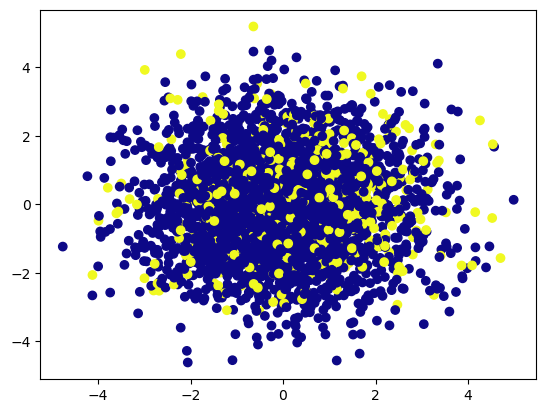

In [44]:
plt.scatter(xPca[:, 0], xPca[:, 1], c = targetOut, cmap = 'plasma')
plt.show()

In [46]:
fig = px.scatter_3d(xPca, x = xPca[:, 0], y = xPca[:, 1], z = xPca[:, 2], color = targetOut)
fig.show()

In [47]:
pca.components_

array([[ 1.38697051e-02, -1.52676213e-02,  1.12110778e-02,
         1.07485537e-02, -9.32776683e-03,  1.64958507e-01,
         1.62642709e-01,  3.14525292e-01, -2.22347676e-02,
         3.14528308e-01,  3.19588389e-01, -8.94989828e-03,
         3.19588446e-01,  2.38356207e-01,  4.00240670e-02,
         2.38345693e-01, -4.61954079e-01, -2.50154794e-02,
        -4.61935120e-01, -1.56349762e-02],
       [-2.27386694e-02,  6.63032501e-03,  2.81017164e-03,
        -1.98110692e-03,  6.80641285e-02,  1.71764590e-01,
         1.70135998e-01,  6.10639913e-02, -3.40590779e-02,
         6.10662295e-02,  4.60503103e-01, -4.35766199e-03,
         4.60507517e-01, -4.68482360e-01, -2.24827151e-04,
        -4.68491577e-01,  1.78226635e-01,  2.99449879e-02,
         1.78205514e-01, -1.41121970e-02],
       [ 1.00514743e-02, -1.95169571e-02,  1.41940388e-02,
        -1.10308509e-02, -7.40432924e-02,  1.93055719e-01,
         1.90198378e-01, -6.20038863e-01, -2.42731225e-02,
        -6.20037575e-01,  1.8

In [48]:
pca.explained_variance_ratio_

array([0.10250926, 0.10189323, 0.09988859, 0.09890585, 0.09617108,
       0.05398296, 0.05278196, 0.05182099, 0.0510352 , 0.05069116,
       0.04935995, 0.04849551, 0.04808435, 0.04756042])

In [49]:
dfPca = pd.DataFrame(pca.components_, columns = df.drop(['churn'], axis = 1).columns)
dfPca

,state,account length,area code,phone number,international plan,voice mail plan,number vmail messages,total day minutes,total day calls,total day charge,total eve minutes,total eve calls,total eve charge,total night minutes,total night calls,total night charge,total intl minutes,total intl calls,total intl charge,customer service calls
0,0.013870,-0.015268,0.011211,0.010749,-0.009328,0.164959,0.162643,0.314525,-0.022235,0.314528,0.319588,-0.008950,0.319588,0.238356,0.040024,0.238346,-0.461954,-0.025015,-0.461935,-0.015635
1,-0.022739,0.006630,0.002810,-0.001981,0.068064,0.171765,0.170136,0.061064,-0.034059,0.061066,0.460503,-0.004358,0.460508,-0.468482,-0.000225,-0.468492,0.178227,0.029945,0.178206,-0.014112
2,0.010051,-0.019517,0.014194,-0.011031,-0.074043,0.193056,0.190198,-0.620039,-0.024273,-0.620038,0.187633,-0.031450,0.187644,0.103805,-0.014804,0.103815,-0.168907,-0.020949,-0.168942,0.009759
3,0.012605,-0.004216,0.023035,-0.007146,-0.035105,-0.415680,-0.418142,-0.083910,-0.027611,-0.083909,-0.042114,-0.003985,-0.042112,-0.368674,-0.010858,-0.368662,-0.422993,-0.031259,-0.423024,0.034211
4,-0.053080,0.005442,0.004868,0.051679,-0.005340,0.480729,0.480690,0.042615,-0.015961,0.042611,-0.383415,0.003006,-0.383404,-0.273067,0.007670,-0.273071,-0.206317,0.000665,-0.206293,0.007020
5,0.040679,0.457312,-0.383028,-0.202918,0.005923,0.003559,0.005066,-0.016290,0.428464,-0.016287,0.006644,0.225096,0.006639,-0.008176,-0.198508,-0.008158,-0.048777,0.409251,-0.048655,-0.393205
6,0.339539,0.202520,0.508647,0.101786,0.624602,-0.002762,-0.005748,-0.041363,0.050731,-0.041361,-0.020654,-0.002245,-0.020631,0.009744,0.324420,0.009725,-0.022940,0.133569,-0.023022,-0.230784
7,-0.307217,0.425166,0.079762,0.428379,0.191565,-0.005016,-0.009430,-0.014749,0.218256,-0.014752,0.029741,0.339357,0.029760,0.022892,-0.167544,0.022903,-0.008521,-0.150169,-0.008542,0.530424
8,-0.246451,0.045248,0.418063,-0.518186,0.121918,0.013645,0.018864,0.017313,0.323473,0.017316,-0.003217,-0.328693,-0.003220,0.001230,-0.439409,0.001206,-0.006980,-0.268380,-0.007011,-0.003539
9,0.543111,0.138523,-0.134033,0.441604,-0.129811,0.011617,0.010112,0.018069,0.243346,0.018067,0.005410,-0.526733,0.005406,-0.019182,-0.277330,-0.019205,0.013153,-0.200795,0.013236,0.009108


<Axes: >

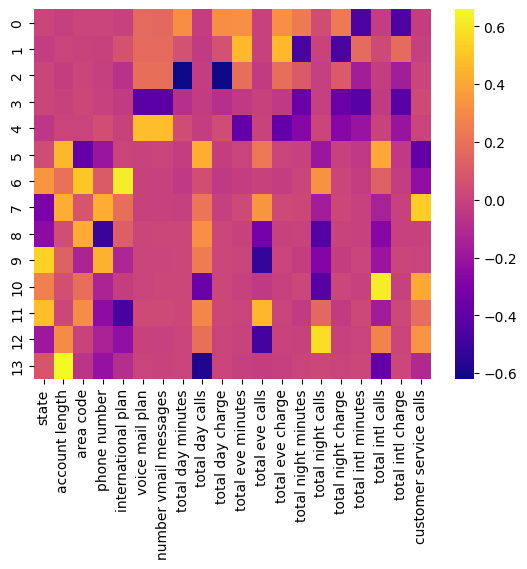

In [50]:
sns.heatmap(dfPca, cmap='plasma')

In [52]:
dfLoading = pd.DataFrame(pca.components_.T, columns = ['PC0', 'PC1', 'PC2', 'PC3', 'PC4','PC5', 'PC6', 'PC7', 'PC8', 'PC9','PC10', 'PC11', 'PC12', 'PC13'], index=df.drop(['churn'], axis = 1).columns)
dfLoading

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13
state,0.013870,-0.022739,0.010051,0.012605,-0.053080,0.040679,0.339539,-0.307217,-0.246451,0.543111,0.261456,0.479833,-0.188861,0.080393
account length,-0.015268,0.006630,-0.019517,-0.004216,0.005442,0.457312,0.202520,0.425166,0.045248,0.138523,0.055118,0.016418,0.305813,0.659118
area code,0.011211,0.002810,0.014194,0.023035,0.004868,-0.383028,0.508647,0.079762,0.418063,-0.134033,0.186759,0.312784,-0.000399,-0.061989
phone number,0.010749,-0.001981,-0.011031,-0.007146,0.051679,-0.202918,0.101786,0.428379,-0.518186,0.441604,-0.133190,-0.243505,-0.140457,-0.217308
international plan,-0.009328,0.068064,-0.074043,-0.035105,-0.005340,0.005923,0.624602,0.191565,0.121918,-0.129811,-0.017951,-0.475245,-0.226380,-0.091190
voice mail plan,0.164959,0.171765,0.193056,-0.415680,0.480729,0.003559,-0.002762,-0.005016,0.013645,0.011617,0.007196,0.033062,-0.003236,0.009281
number vmail messages,0.162643,0.170136,0.190198,-0.418142,0.480690,0.005066,-0.005748,-0.009430,0.018864,0.010112,0.018185,0.034455,-0.007691,0.001866
total day minutes,0.314525,0.061064,-0.620039,-0.083910,0.042615,-0.016290,-0.041363,-0.014749,0.017313,0.018069,0.018583,0.023237,0.004968,0.008607
total day calls,-0.022235,-0.034059,-0.024273,-0.027611,-0.015961,0.428464,0.050731,0.218256,0.323473,0.243346,-0.366225,0.285956,0.197551,-0.582039
total day charge,0.314528,0.061066,-0.620038,-0.083909,0.042611,-0.016287,-0.041361,-0.014752,0.017316,0.018067,0.018580,0.023238,0.004966,0.008606


In [53]:
fig = px.scatter_3d(dfLoading, x='PC1', y='PC2', z='PC3', text = dfLoading.index)
fig.show()

In [56]:
dfScores = pd.DataFrame(xPca, columns = ['PC0', 'PC1', 'PC2', 'PC3', 'PC4','PC5', 'PC6', 'PC7', 'PC8', 'PC9','PC10', 'PC11', 'PC12', 'PC13'])
dfScores['Class'] = targetOut
dfScores

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,Class
0,1.873400,-0.260164,-1.214450,-2.029802,1.158761,0.585997,-0.762590,0.504642,0.442351,0.400155,-0.666799,-0.220902,-0.094494,0.442704,0
1,-0.437419,-0.276990,0.730581,-3.006560,0.313316,0.601444,-0.138764,-0.123528,0.083391,0.703206,-0.904343,0.823773,-0.065670,-0.073336,0
2,-1.492784,-0.581794,-2.707056,0.340065,0.789615,1.536307,0.093654,-0.613023,-0.069560,0.020935,-0.579532,0.574800,0.058280,0.524998,0
3,0.561862,-2.588410,-3.737860,1.443228,2.258667,-0.247206,1.476631,-0.429066,-0.314964,-0.093606,1.651402,-2.347205,-0.883502,-0.009164,0
4,-1.116368,-0.820412,-0.603681,0.802742,0.231869,-0.099362,1.678800,0.308470,0.304839,-1.382242,-0.469438,0.196388,-0.388213,-0.527188,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3328,1.275314,-0.585821,1.638824,-2.524123,0.894007,0.995006,-0.685873,2.455290,-1.059807,-0.660450,0.781603,-0.998541,-0.268588,1.513313,0
3329,0.050153,-0.862932,-1.543093,0.882277,0.365551,-2.290861,-0.158796,-1.902418,-1.003144,1.177607,1.043275,-0.477831,1.221291,0.967563,0
3330,-0.428820,2.012351,0.054998,-0.610946,-2.531064,-1.314820,0.168775,-2.080482,2.075697,0.561850,1.265740,0.605809,0.753081,-1.331435,0
3331,0.778291,-0.091349,-1.236230,2.782647,1.607307,0.822748,3.605473,1.090537,0.637216,-1.717821,0.760443,-1.813263,2.503367,-0.088249,0


In [57]:
fig = px.scatter_3d(dfScores, x='PC1', y='PC2', z='PC3', color='Class')
fig.show()

In [58]:
pca_xTrain, pca_xTest, pca_yTrain, pca_yTest = train_test_split(xPca, targetOut, test_size = 0.2, random_state = 42)

In [59]:
regModel = LogisticRegression()
regModel.fit(pca_xTrain, pca_yTrain)
regScore = regModel.score(pca_xTest, pca_yTest)
regScore

0.856071964017991

In [60]:
regPred = regModel.predict(pca_xTest)
regPred

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

In [61]:
regCM = metrics.confusion_matrix(pca_yTest, regPred)
regCM

array([[557,   9],
       [ 87,  14]], dtype=int64)

In [62]:
regAccuracy = metrics.accuracy_score(pca_yTest, regPred)
print('Accuracy: ', regAccuracy)
regPrecision = metrics.precision_score(pca_yTest, regPred, average = 'macro')
print('Precision: ', regPrecision)
regRecall = metrics.recall_score(pca_yTest, regPred, average = 'macro')
print('Recall: ', regRecall)
regF1 = metrics.f1_score(pca_yTest, regPred, average = 'macro')
print('F1 Score: ', regF1)

Accuracy:  0.856071964017991
Precision:  0.7368012422360248
Recall:  0.5613564006577336
F1 Score:  0.5732338043188483


Text(0.5, 1.0, 'LogisticRegression (After PCA) \nAccuracy: 0.856071964017991, Precision: 0.7368012422360248\nRecall: 0.5613564006577336, F1_Score: 0.5732338043188483 ')

<Figure size 200x200 with 0 Axes>

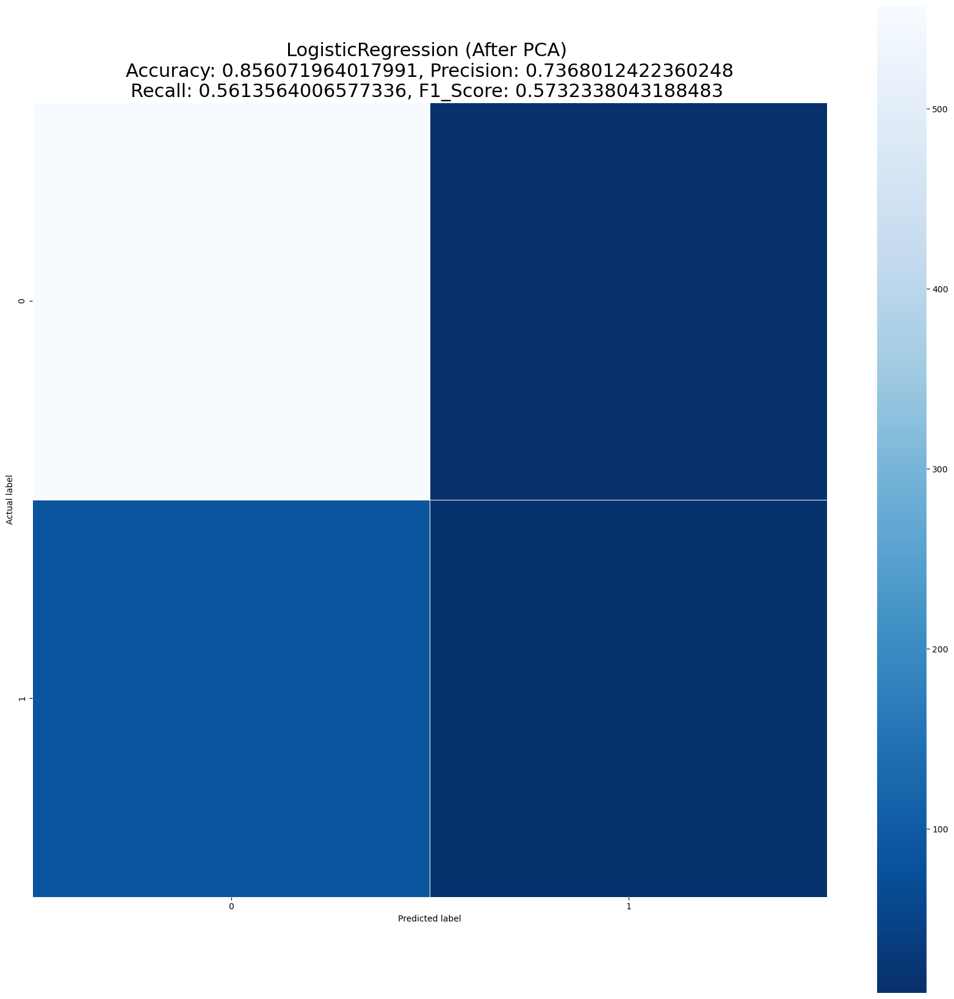

In [63]:
plt.figure(figsize=(regCM.shape))
plt.figure(figsize=(df.corr().shape))
sns.heatmap(regCM, linewidths=.5, square = True, cmap = 'Blues_r')
plt.ylabel('Actual label');
plt.xlabel('Predicted label');
titleStuff = 'LogisticRegression (After PCA) \nAccuracy: {0}, Precision: {1}\nRecall: {2}, F1_Score: {3} '.format(regAccuracy, regPrecision, regRecall, regF1)
plt.title(titleStuff, size = 22)

In [64]:
rfModel = RandomForestClassifier()
rfModel.fit(pca_xTrain, pca_yTrain)
rfScore = rfModel.score(pca_xTest, pca_yTest)
rfScore

0.889055472263868

In [65]:
rfPred = rfModel.predict(pca_xTest)
rfPred

array([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,

In [66]:
rfCM = metrics.confusion_matrix(pca_yTest, rfPred)
rfCM

array([[563,   3],
       [ 71,  30]], dtype=int64)

In [67]:
rfAccuracy = metrics.accuracy_score(pca_yTest, rfPred)
print('Accuracy: ', rfAccuracy)
rfPrecision = metrics.precision_score(pca_yTest, rfPred, average = 'macro')
print('Precision: ', rfPrecision)
rfRecall = metrics.recall_score(pca_yTest, rfPred, average = 'macro')
print('Recall: ', rfRecall)
rfF1 = metrics.f1_score(pca_yTest, rfPred, average = 'macro')
print('F1 Score: ', rfF1)

Accuracy:  0.889055472263868
Precision:  0.8985517636937195
Recall:  0.6458646748067033
F1 Score:  0.6930472636815921


Text(0.5, 1.0, 'RandomForest (After PCA) \nAccuracy: 0.889055472263868, Precision: 0.8985517636937195\nRecall: 0.6458646748067033, F1_Score: 0.6930472636815921 ')

<Figure size 200x200 with 0 Axes>

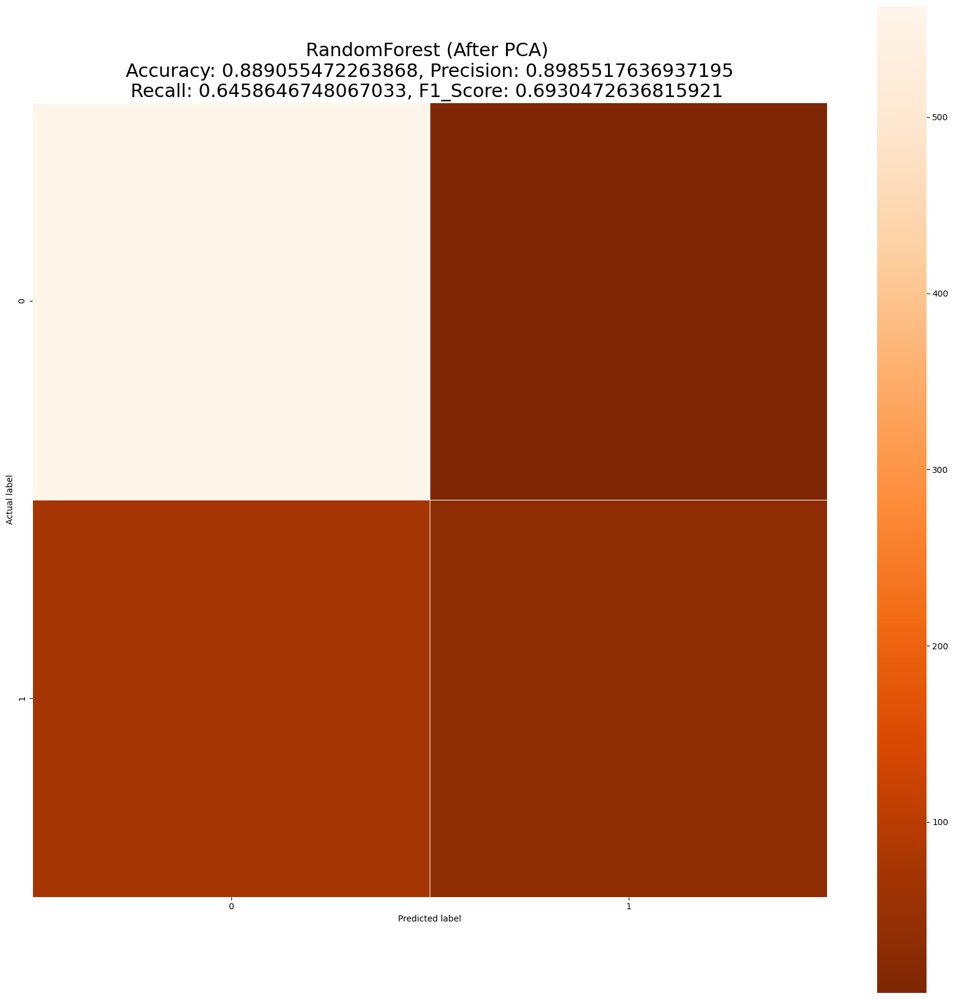

In [68]:
plt.figure(figsize=(rfCM.shape))
plt.figure(figsize=(df.corr().shape))
sns.heatmap(rfCM, linewidths=.5, square = True, cmap = 'Oranges_r')
plt.ylabel('Actual label')
plt.xlabel('Predicted label')
titleStuff = 'RandomForest (After PCA) \nAccuracy: {0}, Precision: {1}\nRecall: {2}, F1_Score: {3} '.format(rfAccuracy, rfPrecision, rfRecall, rfF1)
plt.title(titleStuff, size = 22)

In [69]:
knnModel = KNeighborsClassifier(n_neighbors=35)
knnModel.fit(pca_xTrain, pca_yTrain)
knnScore = knnModel.score(pca_xTest, pca_yTest)
knnScore

0.8575712143928036

In [70]:
knnPred = knnModel.predict(pca_xTest)
knnPred

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,

In [71]:
knnCM = metrics.confusion_matrix(pca_yTest, knnPred)
knnCM

array([[566,   0],
       [ 95,   6]], dtype=int64)

In [72]:
knnAccuracy = metrics.accuracy_score(pca_yTest, knnPred)
print('Accuracy: ', knnAccuracy)
knnPrecision = metrics.precision_score(pca_yTest, knnPred, average = 'macro')
print('Precision: ', knnPrecision)
knnRecall = metrics.recall_score(pca_yTest, knnPred, average = 'macro')
print('Recall: ', knnRecall)
knnF1 = metrics.f1_score(pca_yTest, knnPred, average = 'macro')
print('F1 Score: ', knnF1)

Accuracy:  0.8575712143928036
Precision:  0.9281391830559758
Recall:  0.5297029702970297
F1 Score:  0.5173624599166724


Text(0.5, 1.0, 'KNN (After PCA) \nAccuracy: 0.8575712143928036, Precision: 0.9281391830559758\nRecall: 0.5297029702970297, F1_Score: 0.5173624599166724 ')

<Figure size 200x200 with 0 Axes>

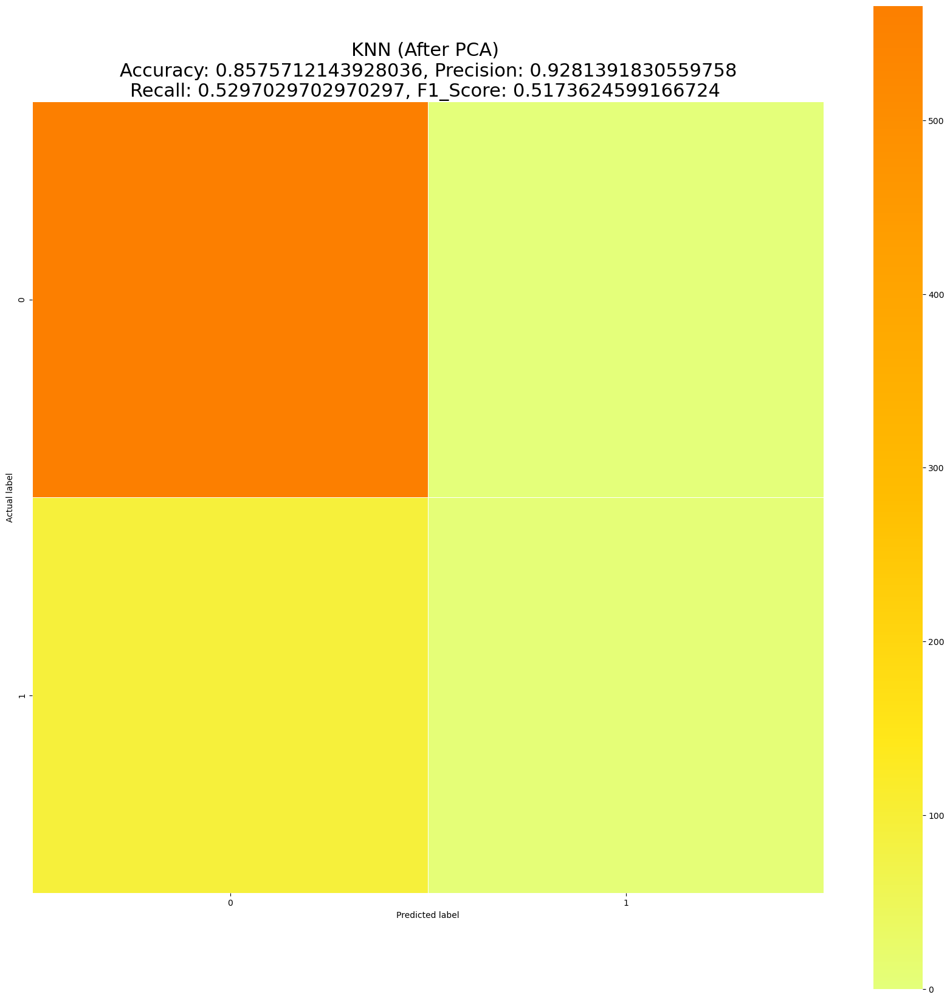

In [73]:
plt.figure(figsize=(knnCM.shape))
plt.figure(figsize=(df.corr().shape))
sns.heatmap(knnCM, linewidths=.5, square = True, cmap = 'Wistia')
plt.ylabel('Actual label')
plt.xlabel('Predicted label')
titleStuff = 'KNN (After PCA) \nAccuracy: {0}, Precision: {1}\nRecall: {2}, F1_Score: {3} '.format(knnAccuracy, knnPrecision, knnRecall, knnF1)
plt.title(titleStuff, size = 22)